Segment customers of an e-commerce site
=================

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
from scipy import stats
from datetime import date,timedelta,datetime
from kmodes.kprototypes import KPrototypes
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import scipy.cluster.hierarchy as shc  
import plotly.express as px
import plotly.offline as pyoff
import plotly

from yellowbrick.cluster import KElbowVisualizer,SilhouetteVisualizer,InterclusterDistance
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE
import scipy.cluster.hierarchy as shc
from sklearn.metrics.cluster import adjusted_rand_score
from sklearn.datasets import make_blobs
from sklearn.datasets import make_moons

In [2]:
customer = pd.read_csv('olist_customers_dataset.csv')
order = pd.read_csv('olist_orders_dataset.csv')
item = pd.read_csv('olist_order_items_dataset.csv')
payment = pd.read_csv('olist_order_payments_dataset.csv')

In [3]:
df = customer.merge(order, how='inner', on='customer_id')
df = df.merge(item, how='inner', on='order_id')
df = df.merge(payment, how='inner', on='order_id')

In [4]:
df.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,...,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,payment_sequential,payment_type,payment_installments,payment_value
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,...,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,2017-05-22 15:22:12,124.99,21.88,1,credit_card,2,146.87
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,...,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,2018-01-18 20:58:32,289.00,46.48,1,credit_card,8,335.48
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,...,1,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,2018-06-05 16:19:10,139.94,17.79,1,credit_card,7,157.73
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,...,1,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,2018-03-27 16:31:16,149.94,23.36,1,credit_card,1,173.30
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,...,1,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,2018-07-31 10:10:09,230.00,22.25,1,credit_card,8,252.25


In [5]:
df.columns

Index(['customer_id', 'customer_unique_id', 'customer_zip_code_prefix',
       'customer_city', 'customer_state', 'order_id', 'order_status',
       'order_purchase_timestamp', 'order_approved_at',
       'order_delivered_carrier_date', 'order_delivered_customer_date',
       'order_estimated_delivery_date', 'order_item_id', 'product_id',
       'seller_id', 'shipping_limit_date', 'price', 'freight_value',
       'payment_sequential', 'payment_type', 'payment_installments',
       'payment_value'],
      dtype='object')

In [8]:
df.duplicated().sum()

0

In [9]:
df= df.loc[df.order_status=='delivered']

In [10]:
date_columns = ['order_purchase_timestamp','order_approved_at', 
                'order_delivered_carrier_date','order_delivered_customer_date', 
                'order_estimated_delivery_date']
for col in date_columns:
    df[col] = pd.to_datetime(df[col])
df.dtypes

customer_id                              object
customer_unique_id                       object
customer_zip_code_prefix                  int64
customer_city                            object
customer_state                           object
order_id                                 object
order_status                             object
order_purchase_timestamp         datetime64[ns]
order_approved_at                datetime64[ns]
order_delivered_carrier_date     datetime64[ns]
order_delivered_customer_date    datetime64[ns]
order_estimated_delivery_date    datetime64[ns]
order_item_id                             int64
product_id                               object
seller_id                                object
shipping_limit_date                      object
price                                   float64
freight_value                           float64
payment_sequential                        int64
payment_type                             object
payment_installments                    

In [11]:
df = df[['customer_unique_id', 'order_id', 'payment_type', 'order_delivered_carrier_date', 
         'order_purchase_timestamp' ,'order_approved_at', 'payment_value']]

In [12]:
df.isna().sum().sort_values(ascending=False)

order_approved_at               15
order_delivered_carrier_date     2
customer_unique_id               0
order_id                         0
payment_type                     0
order_purchase_timestamp         0
payment_value                    0
dtype: int64

In [13]:
df=df.dropna()

In [14]:
df.isna().sum().sort_values(ascending=False)

customer_unique_id              0
order_id                        0
payment_type                    0
order_delivered_carrier_date    0
order_purchase_timestamp        0
order_approved_at               0
payment_value                   0
dtype: int64

#### RFM dataset (feature engineering)

In [15]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFM = df.groupby('customer_unique_id').agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [16]:
RFM.columns=['Recency', 'Frequency', 'MonetaryValue']

In [17]:
RFM.head()

,Recency,Frequency,MonetaryValue
customer_unique_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,123,1,141.90
0000b849f77a49e4a4ce2b2a4ca5be3f,126,1,27.19
0000f46a3911fa3c0805444483337064,548,1,86.22
0000f6ccb0745a6a4b88665a16c9f078,333,1,43.62
0004aac84e0df4da2b147fca70cf8255,299,1,196.89


<AxesSubplot:xlabel='MonetaryValue'>

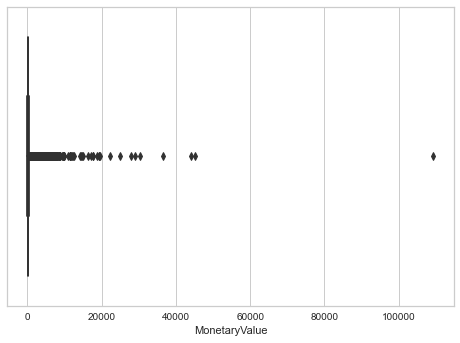

In [18]:
sns.boxplot(x=RFM['MonetaryValue'])

In [19]:
q1_mv = RFM['MonetaryValue'].quantile(0.25)
q3_mv = RFM['MonetaryValue'].quantile(0.75)
IQR = q3_mv - q1_mv
RFM = RFM[(RFM['MonetaryValue'] > q1_mv - 1.5*IQR) & (RFM['MonetaryValue'] < q3_mv + 1.5*IQR)]

<AxesSubplot:xlabel='MonetaryValue'>

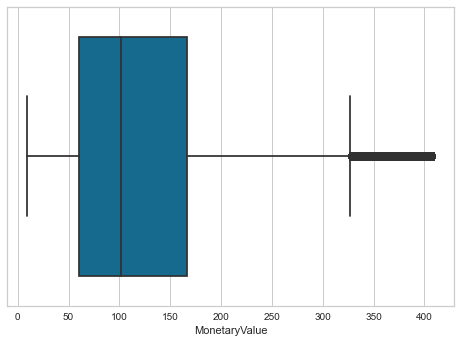

In [20]:
sns.boxplot(x=RFM['MonetaryValue'])

<AxesSubplot:xlabel='Recency', ylabel='Density'>

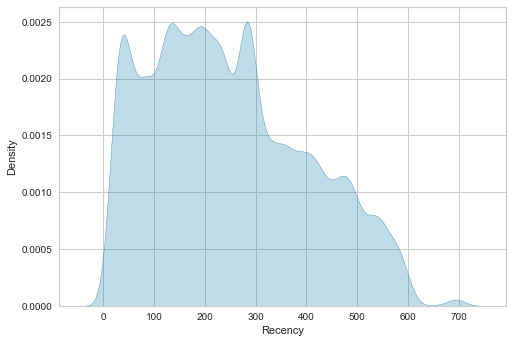

In [21]:
sns.kdeplot(x=RFM['Recency'], fill=True)

In [22]:
std = StandardScaler()
rfm_std = std.fit_transform(RFM)

In [23]:
rfm_stan = pd.DataFrame(rfm_std, columns=RFM.columns)
rfm_stan.head()

,Recency,Frequency,MonetaryValue
0,-0.823407,-0.2665,0.203034
1,-0.803693,-0.2665,-1.148154
2,1.969397,-0.2665,-0.452830
3,0.556567,-0.2665,-0.954622
4,0.333142,-0.2665,0.850771


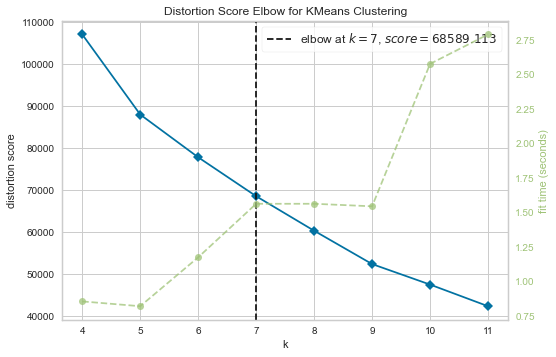

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [24]:
model = KMeans()
visualizer = KElbowVisualizer(model, k=(4,12))

visualizer.fit(rfm_std)        # Fit the data to the visualizer
visualizer.show() 

In [30]:
model_k = KMeans(n_clusters=6)
kmeans = model_k.fit(rfm_std)
RFM['kmcluster'] = kmeans.labels_

In [31]:
kmeans.cluster_centers_.shape

(6, 3)

In [32]:
RFM.head()

,Recency,Frequency,MonetaryValue,kmcluster
customer_unique_id,,,,
0000366f3b9a7992bf8c76cfdf3221e2,123,1,141.90,4
0000b849f77a49e4a4ce2b2a4ca5be3f,126,1,27.19,4
0000f46a3911fa3c0805444483337064,548,1,86.22,3
0000f6ccb0745a6a4b88665a16c9f078,333,1,43.62,0
0004aac84e0df4da2b147fca70cf8255,299,1,196.89,1


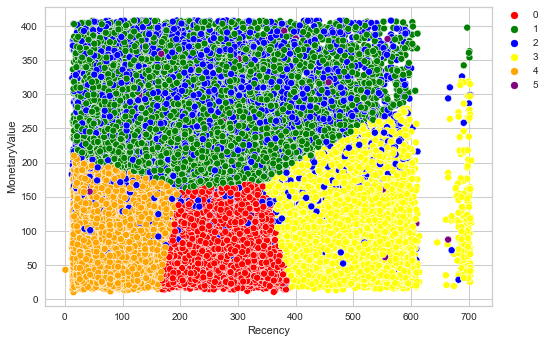

In [34]:
sns.scatterplot(data=RFM, x="Recency", y="MonetaryValue", hue="kmcluster", 
                palette=['red', 'green', 'blue', 'yellow', 'orange', 'purple'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);

In [35]:
px.scatter_3d(RFM, x='Recency',y='Frequency', z='MonetaryValue', color='kmcluster')

In [36]:
n_clusters = kmeans.labels_
pd.Series(n_clusters).value_counts()

4    24530
0    23179
3    15972
1    12535
2     7788
5      194
dtype: int64

In [37]:
kmeans_score = silhouette_score(rfm_std, kmeans.labels_, metric='euclidean')
round(kmeans_score,4)

0.3316

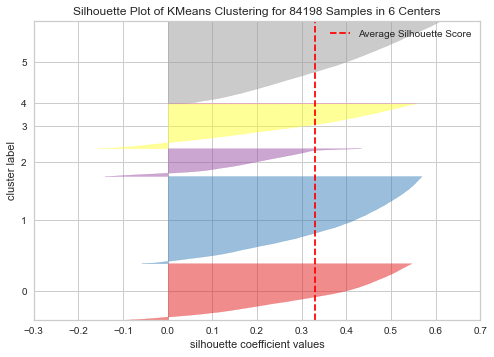

<AxesSubplot:title={'center':'Silhouette Plot of KMeans Clustering for 84198 Samples in 6 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [38]:
model = KMeans(n_clusters=6)
visualizer = SilhouetteVisualizer(model)

visualizer.fit(rfm_std)    # Fit the data to the visualizer
visualizer.poof()    # Draw/show/poof the data

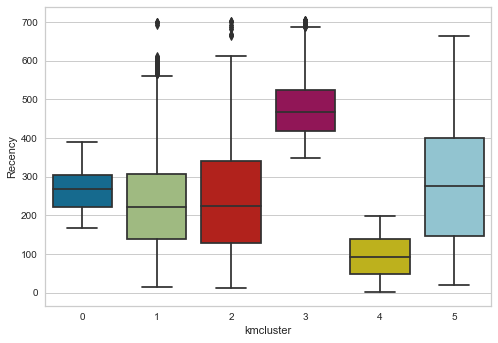

In [39]:
sns.boxplot(x='kmcluster', y='Recency', data=RFM);

<AxesSubplot:xlabel='kmcluster', ylabel='Frequency'>

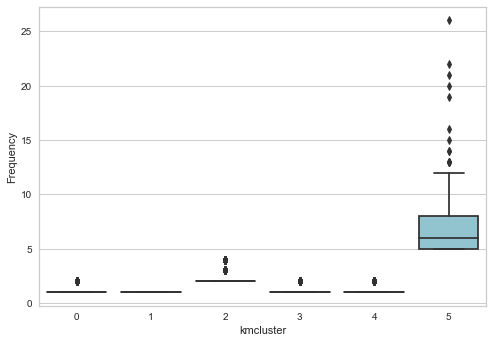

In [40]:
sns.boxplot(x='kmcluster', y='Frequency', data=RFM);

<AxesSubplot:xlabel='kmcluster', ylabel='MonetaryValue'>

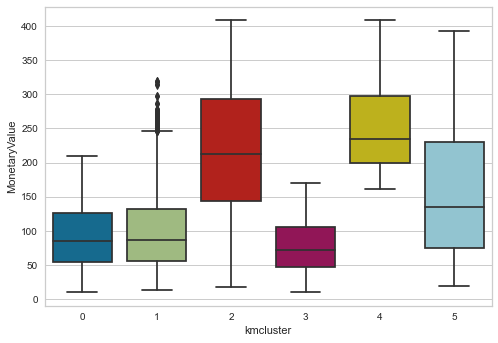

In [33]:
sns.boxplot(x='kmcluster', y='MonetaryValue', data=RFM);

#### ACP Analysis pour K-Means

In [41]:
pca=PCA(n_components=2)
principal_comp=pca.fit_transform(rfm_std)
principal_comp

array([[-0.05306269, -0.84502029],
       [-1.00791272, -0.74606622],
       [-0.48927476,  1.97864701],
       ...,
       [-0.26868317,  2.17676934],
       [-0.12083737, -0.78036483],
       [-0.61467785,  1.64800608]])

In [42]:
pca_df=pd.DataFrame(data=principal_comp,columns=['pca1','pca2'])
pca_df.head()

,pca1,pca2
0,-0.053063,-0.845020
1,-1.007913,-0.746066
2,-0.489275,1.978647
3,-0.857793,0.599122
4,0.416100,0.270359


In [43]:
RFM.reset_index(inplace=True) 

In [44]:
pca_df=pd.concat([pca_df, RFM['kmcluster']],axis=1)
pca_df.head()

,pca1,pca2,kmcluster
0,-0.053063,-0.845020,4
1,-1.007913,-0.746066,4
2,-0.489275,1.978647,3
3,-0.857793,0.599122,0
4,0.416100,0.270359,1


<AxesSubplot:xlabel='pca1', ylabel='pca2'>

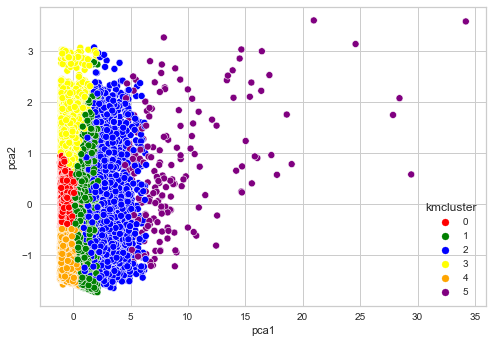

In [45]:
sns.scatterplot(x='pca1', y='pca2', hue='kmcluster', data=pca_df, 
                palette=['red', 'green', 'blue', 'yellow','orange','purple']);

#### TSNE pour KMeans

In [46]:
tsne=TSNE(n_components=2, random_state=0)

In [47]:
tsne=tsne.fit_transform(rfm_std)

/Users/sanjibansantra/opt/anaconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/Users/sanjibansantra/opt/anaconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [53]:
tsne_df=pd.DataFrame(data=tsne, columns=['tsne1','tsne2'])

In [54]:
tsne_df=pd.concat([tsne_df, RFM['kmcluster']], axis=1)
tsne_df.head()

,tsne1,tsne2,kmcluster
0,-10.039543,57.215389,4
1,-23.873575,-13.282156,4
2,-50.400448,-14.600005,3
3,6.410013,-20.873098,0
4,23.142891,-17.488260,1


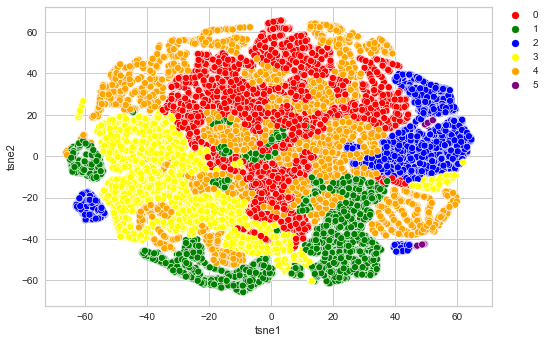

In [55]:
sns.scatterplot(x='tsne1', y='tsne2', hue='kmcluster', data=tsne_df, 
                palette=['red', 'green', 'blue', 'yellow','orange','purple'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0);

#### K-Proptotype Clustering

In [56]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFMP = df.groupby(['customer_unique_id', 'payment_type']).agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [57]:
RFMP.reset_index(inplace=True)

In [58]:
RFMP.columns=['customer_unique_id', 'payment_type', 'Recency', 'Frequency', 'MonetaryValue']
RFMP.head()

,customer_unique_id,payment_type,Recency,Frequency,MonetaryValue
0,0000366f3b9a7992bf8c76cfdf3221e2,credit_card,123,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,credit_card,126,1,27.19
2,0000f46a3911fa3c0805444483337064,credit_card,548,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,credit_card,333,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,credit_card,299,1,196.89


In [59]:
q1_mv = RFMP['MonetaryValue'].quantile(0.25)
q3_mv = RFMP['MonetaryValue'].quantile(0.75)
IQR = q3_mv - q1_mv
RFMP = RFMP[(RFMP['MonetaryValue'] > q1_mv - 1.5*IQR) & (RFMP['MonetaryValue'] < q3_mv + 1.5*IQR)]

In [60]:
RFMP.isnull().any()

customer_unique_id    False
payment_type          False
Recency               False
Frequency             False
MonetaryValue         False
dtype: bool

In [61]:
print(np.__version__)

1.22.3


In [63]:
for c in RFMP.select_dtypes(exclude='object').columns:
    std = StandardScaler()
    RFMP[c] =  std.fit_transform(np.array(RFMP[c]).reshape(-1, 1))

In [64]:
kproto = KPrototypes(n_clusters= 6, init='Cao', n_jobs = -1)
kcluster = kproto.fit(RFMP, categorical=[0, 1])

In [65]:
labels = kcluster.labels_
pd.Series(labels).value_counts()

2    24940
5    24073
1    16719
3    13511
4     6293
0      952
dtype: int64

In [66]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFMP1 = df.groupby(['customer_unique_id', 'payment_type']).agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [67]:
RFMP1.reset_index(inplace=True)

In [68]:
RFMP1.columns=['customer_unique_id', 'payment_type', 'Recency', 'Frequency', 'MonetaryValue']
RFMP1.head()

,customer_unique_id,payment_type,Recency,Frequency,MonetaryValue
0,0000366f3b9a7992bf8c76cfdf3221e2,credit_card,123,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,credit_card,126,1,27.19
2,0000f46a3911fa3c0805444483337064,credit_card,548,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,credit_card,333,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,credit_card,299,1,196.89


In [69]:
q1_mv = RFMP1['MonetaryValue'].quantile(0.25)
q3_mv = RFMP1['MonetaryValue'].quantile(0.75)
IQR = q3_mv - q1_mv
RFMP1 = RFMP1[(RFMP1['MonetaryValue'] > q1_mv - 1.5*IQR) & (RFMP1['MonetaryValue'] < q3_mv + 1.5*IQR)]

In [70]:
RFMP1.shape

(86488, 5)

In [71]:
RFMP.shape

(86488, 5)

In [72]:
RFMP1['kpcluster']= kcluster.labels_

In [73]:
RFMP1.head()

,customer_unique_id,payment_type,Recency,Frequency,MonetaryValue,kpcluster
0,0000366f3b9a7992bf8c76cfdf3221e2,credit_card,123,1,141.90,2
1,0000b849f77a49e4a4ce2b2a4ca5be3f,credit_card,126,1,27.19,2
2,0000f46a3911fa3c0805444483337064,credit_card,548,1,86.22,1
3,0000f6ccb0745a6a4b88665a16c9f078,credit_card,333,1,43.62,5
4,0004aac84e0df4da2b147fca70cf8255,credit_card,299,1,196.89,3


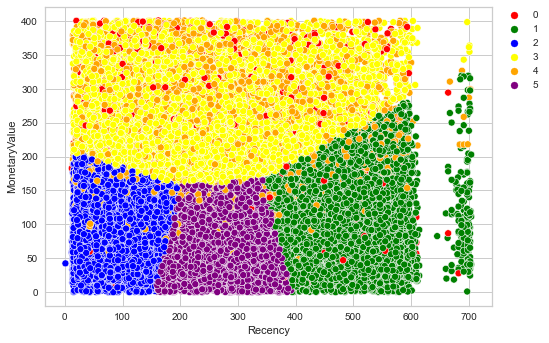

In [74]:
sns.scatterplot(x='Recency', y='MonetaryValue', hue= 'kpcluster', data=RFMP1,
                palette=['red', 'green', 'blue', 'yellow', 'orange', 'purple'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

In [75]:
px.scatter_3d(RFMP1, x='Recency', y='Frequency', z='MonetaryValue', color='kpcluster')

In [76]:
RFMP2= RFMP1.drop(columns=['customer_unique_id', 'payment_type', 'kpcluster'])

In [77]:
RFMP2_std = std.fit_transform(RFMP2)

In [78]:
kproto_score = silhouette_score(RFMP2_std, kcluster.labels_, metric='euclidean')
round(kproto_score, 4)

0.3431

#### ACP pour K-Prototype

In [79]:
pca=PCA(n_components=2)
principal_comp=pca.fit_transform(RFMP2_std)
principal_comp

array([[ 0.01327361, -0.85096486],
       [-0.95379695, -0.76684598],
       [-0.47680378,  1.962916  ],
       ...,
       [-0.2572291 ,  2.16422626],
       [-0.05636997, -0.78742481],
       [-0.59784031,  1.6306989 ]])

In [80]:
pca_df=pd.DataFrame(data=principal_comp,columns=['pca1','pca2'])
pca_df.head()

,pca1,pca2
0,0.013274,-0.850965
1,-0.953797,-0.766846
2,-0.476804,1.962916
3,-0.825403,0.579201
4,0.468214,0.270443


In [81]:
pca_df=pd.concat([pca_df, RFMP1['kpcluster']], axis=1)
pca_df.head()

,pca1,pca2,kpcluster
0,0.013274,-0.850965,2.0
1,-0.953797,-0.766846,2.0
2,-0.476804,1.962916,1.0
3,-0.825403,0.579201,5.0
4,0.468214,0.270443,3.0


<AxesSubplot:xlabel='pca1', ylabel='pca2'>

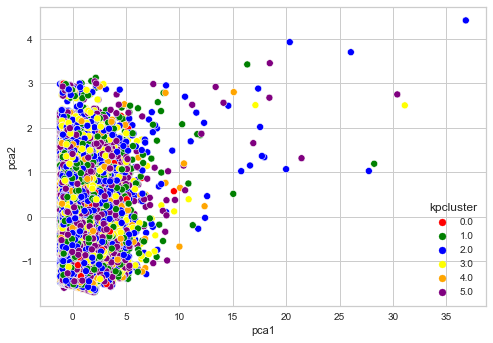

In [82]:
sns.scatterplot(x='pca1', y='pca2', hue='kpcluster', data=pca_df, 
                palette=['red', 'green', 'blue', 'yellow','orange','purple'])

#### TSNE for KPrototype

In [83]:
tsne=TSNE(n_components=2, random_state=0)

In [84]:
tsne=tsne.fit_transform(RFMP2_std)

/Users/sanjibansantra/opt/anaconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/Users/sanjibansantra/opt/anaconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [85]:
tsne_df=pd.DataFrame(data=tsne, columns=['tsne1','tsne2'])

In [86]:
tsne_df=pd.concat([tsne_df, RFMP1['kpcluster']], axis=1)
tsne_df.head()

,tsne1,tsne2,kpcluster
0,-4.064383,12.984753,2.0
1,-33.959793,-43.711006,2.0
2,-45.052200,-5.486850,1.0
3,23.483599,-36.741016,5.0
4,39.951878,-8.557728,3.0


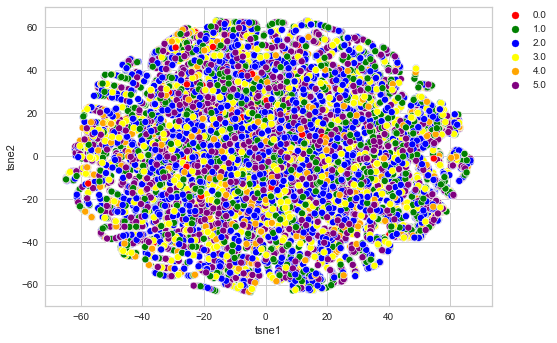

In [87]:
sns.scatterplot(x='tsne1', y='tsne2', hue='kpcluster', data=tsne_df, 
                palette=['red', 'green', 'blue', 'yellow','orange','purple'])
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

<AxesSubplot:xlabel='kpcluster', ylabel='Recency'>

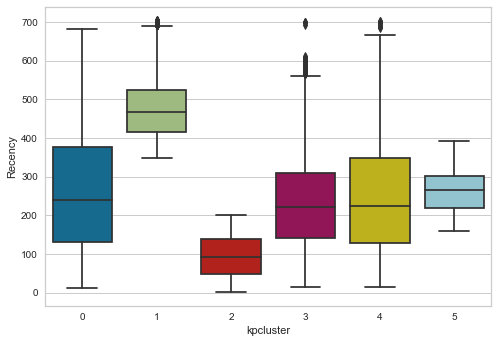

In [88]:
sns.boxplot(x='kpcluster', y='Recency', data=RFMP1)

<AxesSubplot:xlabel='kpcluster', ylabel='Frequency'>

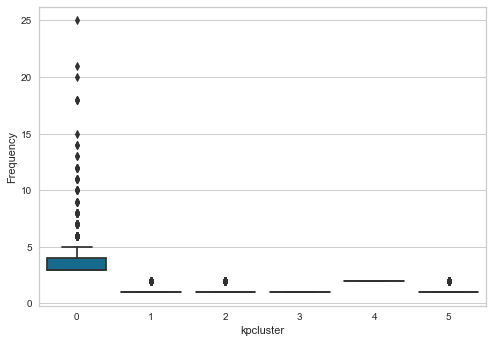

In [89]:
sns.boxplot(x='kpcluster', y='Frequency', data=RFMP1)

<AxesSubplot:xlabel='kpcluster', ylabel='MonetaryValue'>

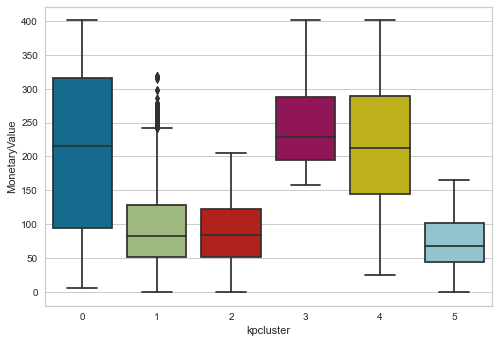

In [90]:
sns.boxplot(x='kpcluster', y='MonetaryValue', data=RFMP1)

#### DBSCAN Clustering

In [91]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFMDB = df.groupby('customer_unique_id').agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [92]:
RFMDB.columns=['Recency', 'Frequency', 'MonetaryValue']
RFMDB.head()

,Recency,Frequency,MonetaryValue
customer_unique_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,123,1,141.90
0000b849f77a49e4a4ce2b2a4ca5be3f,126,1,27.19
0000f46a3911fa3c0805444483337064,548,1,86.22
0000f6ccb0745a6a4b88665a16c9f078,333,1,43.62
0004aac84e0df4da2b147fca70cf8255,299,1,196.89


In [93]:
q1_mv = RFMDB['MonetaryValue'].quantile(0.25)
q3_mv = RFMDB['MonetaryValue'].quantile(0.75)
IQR = q3_mv - q1_mv
RFMP1 = RFMDB[(RFMDB['MonetaryValue'] > q1_mv - 1.5*IQR) & (RFMDB['MonetaryValue'] < q3_mv + 1.5*IQR)]

In [95]:
std = StandardScaler()
rfmdb_std = std.fit_transform(RFMDB)

In [96]:
from sklearn.neighbors import NearestNeighbors

In [97]:
neighbors = NearestNeighbors(n_neighbors=100)
neighbors_fit = neighbors.fit(rfmdb_std)
distances, indices = neighbors_fit.kneighbors(rfmdb_std)

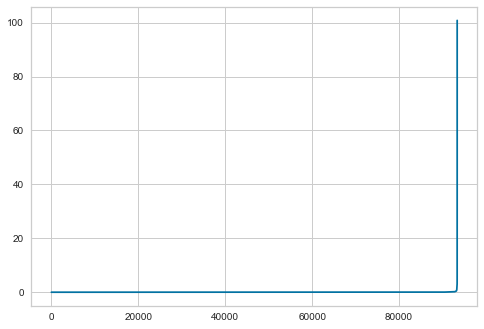

In [98]:
distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

In [99]:
dbscan=DBSCAN(eps=0.5, min_samples=100, n_jobs=-1)

In [100]:
dbs=dbscan.fit(rfmdb_std)

In [101]:
RFMDB['dbcluster'] = dbs.labels_

In [102]:
RFMDB['dbcluster'].value_counts()

 0    79088
 1    10212
-1     2019
 3     1668
 2      355
Name: dbcluster, dtype: int64

In [103]:
RFMDB.head()

,Recency,Frequency,MonetaryValue,dbcluster
customer_unique_id,,,,
0000366f3b9a7992bf8c76cfdf3221e2,123,1,141.90,0
0000b849f77a49e4a4ce2b2a4ca5be3f,126,1,27.19,0
0000f46a3911fa3c0805444483337064,548,1,86.22,0
0000f6ccb0745a6a4b88665a16c9f078,333,1,43.62,0
0004aac84e0df4da2b147fca70cf8255,299,1,196.89,0


In [104]:
RFMDB.reset_index(inplace=True)

In [105]:
px.scatter_3d(RFMDB, x='Recency', y='Frequency', z='MonetaryValue', color='dbcluster')

#### TSNE for DBSCAN

In [106]:
tsne=TSNE(n_components=2, random_state=0)

In [107]:
tsne=tsne.fit_transform(rfmdb_std)

/Users/sanjibansantra/opt/anaconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/Users/sanjibansantra/opt/anaconda3/lib/python3.8/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [108]:
tsne_df=pd.DataFrame(data=tsne, columns=['tsne1','tsne2'])

In [109]:
tsne_df=pd.concat([tsne_df, RFMDB['dbcluster']], axis=1)
tsne_df.head()

,tsne1,tsne2,dbcluster
0,-8.056306,-34.420486,0
1,11.188051,-60.921413,0
2,6.833341,25.927628,0
3,-43.858204,9.499949,0
4,-10.405989,21.958817,0


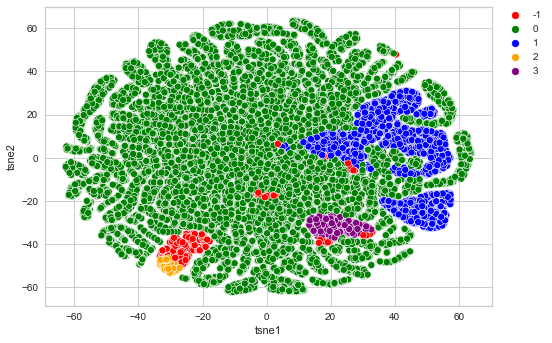

In [110]:
sns.scatterplot(x='tsne1', y='tsne2', hue='dbcluster', palette=['red', 'green', 'blue','orange','purple'], 
                data=tsne_df)
plt.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

In [111]:
dbscan_score = silhouette_score(rfmdb_std, dbs.labels_, metric='euclidean')
round(dbscan_score, 4)

0.3354

In [112]:
data = {'Model': ['KMeans', 'KPrototype', 'DBSCAN'], 
        'SilhoutteScore': [0.3338, 0.3626, 0.3354]}  
df_silhoutte=pd.DataFrame(data)

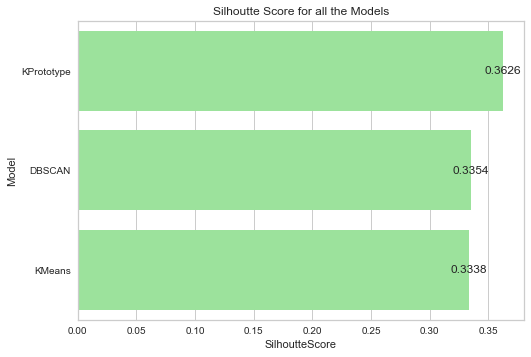

In [113]:
s=sns.barplot(x="SilhoutteScore",y="Model",color='lightgreen', data=df_silhoutte, order=df_silhoutte.sort_values('SilhoutteScore',ascending = False).Model)
for p in s.patches:
    s.annotate(p.get_width(), xy=(p.get_width(), p.get_y()+p.get_height()/2),
            xytext=(0, 0), textcoords='offset points',ha='center', va="center")
    s.set_title('Silhoutte Score for all the Models')

### Since K-Means algo is less time consuming. We choose the KMean algorithm.

### Adjusted RAND index for K-Means model (Stabilite)

Now we check the stability of the KMeans model.

In [114]:
last_date = df['order_delivered_carrier_date'].max() + timedelta(days=1)
RFM = df.groupby('customer_unique_id').agg({
    'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
    'order_id': lambda x: len(x),
    'payment_value': 'sum'
})

In [115]:
RFM.columns=['Recency', 'Frequency','MonetaryValue']

In [116]:
periods = [
           "2018-01-01", "2018-02-01", 
           "2018-03-01", "2018-04-01", 
           "2018-05-01", "2018-06-01", 
           ]
rfm_clusters = []

In [117]:
for d in periods:
  last_date = datetime.strptime(d, "%Y-%m-%d") + timedelta(days=1)
  RFM = df[df['order_delivered_carrier_date']<=d].groupby(
      'customer_unique_id').agg({
          'order_delivered_carrier_date': lambda x: (last_date - x.max()).days,
          'order_id': lambda x: len(x),
          'payment_value': 'sum'
  })
      
  RFM.columns=['Recency','Frequency','MonetaryValue']

  std = StandardScaler()
  rfm_std = std.fit_transform(RFM)

  model = KMeans(n_clusters=6)
  kmeans = model.fit(rfm_std)
  RFM['kmcluster'] = kmeans.labels_

  rfm_clusters.append(RFM)

In [118]:
indices = rfm_clusters[0].index

In [119]:
ari_scores = []
for r in range(len(rfm_clusters)):
  first_month = rfm_clusters[0]['kmcluster']
  second_month = pd.DataFrame(rfm_clusters[r], index=indices)['kmcluster']
  ari = adjusted_rand_score(first_month, second_month)
  ari_scores.append(ari)
print(ari_scores)

[1.0, 0.7794715463966355, 0.5768205603615423, 0.5462439625759312, 0.5168160503757693, 0.40700883177918945]


In [120]:
aris_df = pd.DataFrame.from_dict({"date": periods, "score": ari_scores})
print(aris_df)

         date     score
0  2018-01-01  1.000000
1  2018-02-01  0.779472
2  2018-03-01  0.576821
3  2018-04-01  0.546244
4  2018-05-01  0.516816
5  2018-06-01  0.407009


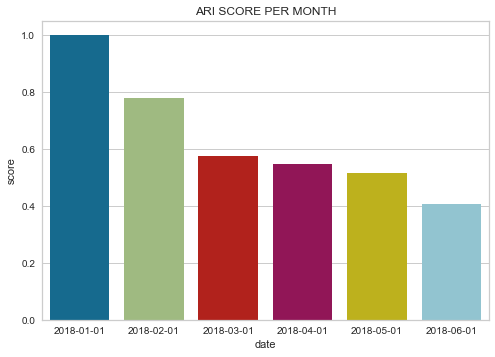

In [121]:
sns.barplot(x='date', y='score', data=aris_df).set_title('ARI SCORE PER MONTH');